In [21]:
import cv2
import os
import numpy as np
import tensorflow as tf
import keras
from tensorflow.keras.models import load_model

from PIL import Image
import numpy as np
from skimage import transform
import imageio
import matplotlib.pyplot as plt

In [22]:
face_cascade = cv2.CascadeClassifier('/Users/swathiasok/Desktop/FYP copy/Haar Cascade/haarcascade_frontalface_default.xml')

In [23]:
d = {'Aishu': 0,
 'Aswini': 1,
 'Kick': 2,
 'Nandana': 3,
 'Raji': 4,
 'Santhosh': 5,
 'Sathish': 6,
 'Sruthi': 7,
 'Suma': 8,
 'Surudhi': 9,
 'Swathi': 10,
 'Varma': 11,
 'Venky': 12,
 'Yoga': 13,
 'Unknown': 14}

In [24]:
key_list = list(d.keys())
val_list = list(d.values())

In [25]:
def predict(face):
    model = load_model("facenet.h5")
    np_image = np.array(face).astype('float32')/255
    np_image = transform.resize(np_image, (160, 160, 3))
    np_image = np.expand_dims(np_image, axis=0)
    pred = model.predict(np_image) 
    cls = pred.argmax(axis=-1)
    print(pred, cls)
    if pred[0][cls] > 0.5:
        position = val_list.index(cls)
    else:
        position = val_list.index(14)
    return key_list[position]
    

In [26]:
def detect(frame, gray, count):
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    i = 0
    for (x, y, w, h) in faces:
        face = frame[y:y+h, x:x+w]
        text = ""
        #text = predict(face)
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 5)
        cv2.putText(frame, text, (x, y), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 2)
        
    plt.figure(figsize = (17, 17))
    plt.imshow(frame[:, :, ::-1])


In [27]:
def load_images_from_folder(folder):
    count = 0
    for f in os.listdir(folder):
        if (f.endswith(".jpg") or f.endswith(".png") or f.endswith(".JPG") or f.endswith(".jpeg") or f.endswith(".HEIC") or f.endswith(".heic")):
            img = cv2.imread(os.path.join(folder,f))
            
            print(f)
            if img is not None:
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                detect(img, gray, count)
                count += 10    

Test_image_006.HEIC
Test_image_0041.jpeg
Test_image_0040.jpeg
Test_image_002.JPG
Test_image_003.JPG
Test_image_0026.jpg
Test_image_0019.JPG
Test_image_0024.jpg
Test_image_0020.JPG
Test_image_0027.jpeg
Test_image_0031.jpeg
Test_image_0038.heic
Test_image_0021.JPG
Test_image_0023.jpg
Test_image_0037.JPG
Test_image_0022.JPG
Test_image_0033.jpeg
Test_image_0028.JPG
Test_image_0016.JPG
Test_image_0029.jpeg
Untitled.png
Test_image_008.jpg
Untitled1.png


/Users/swathiasok/opt/anaconda3/envs/tf/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


Test_image_0039.jpeg
Test_image_009.jpg
Untitled3.png
Test_image_005.heic


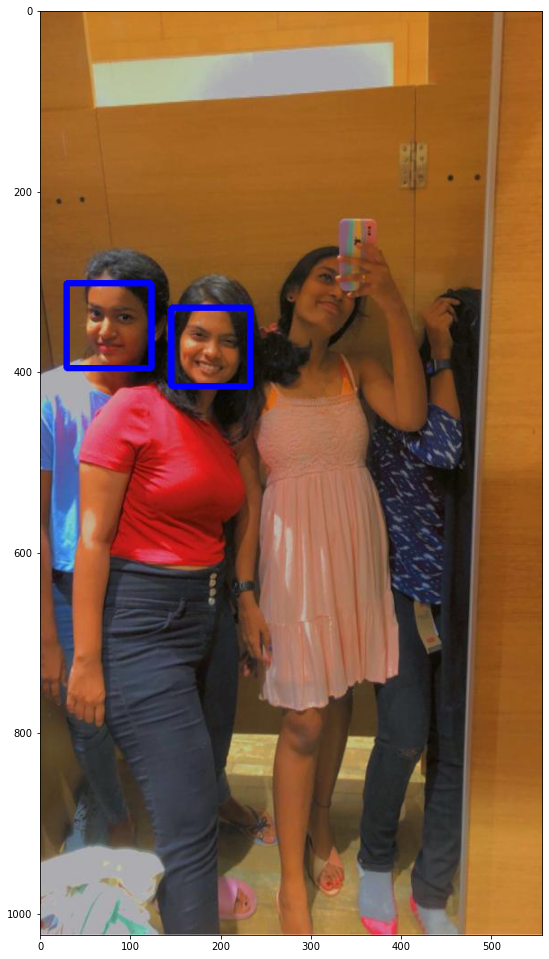

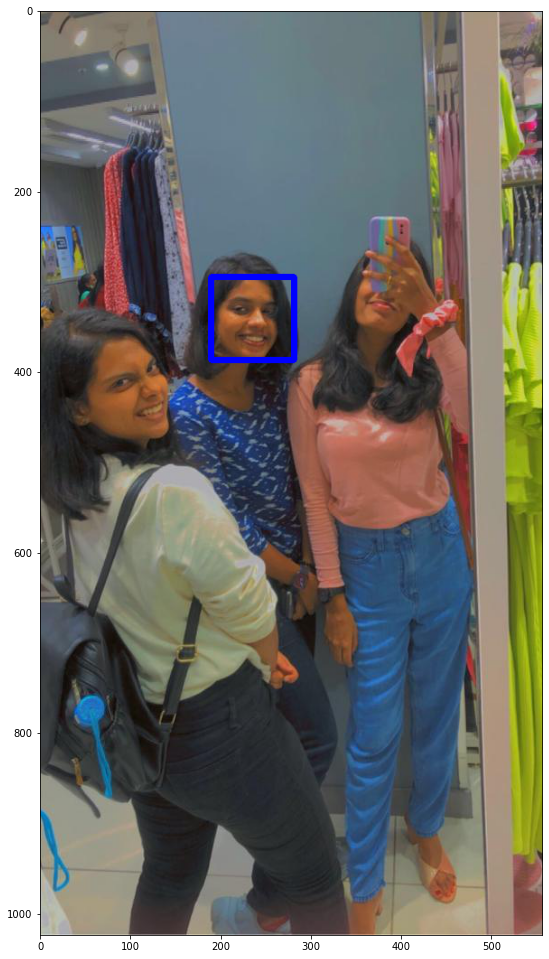

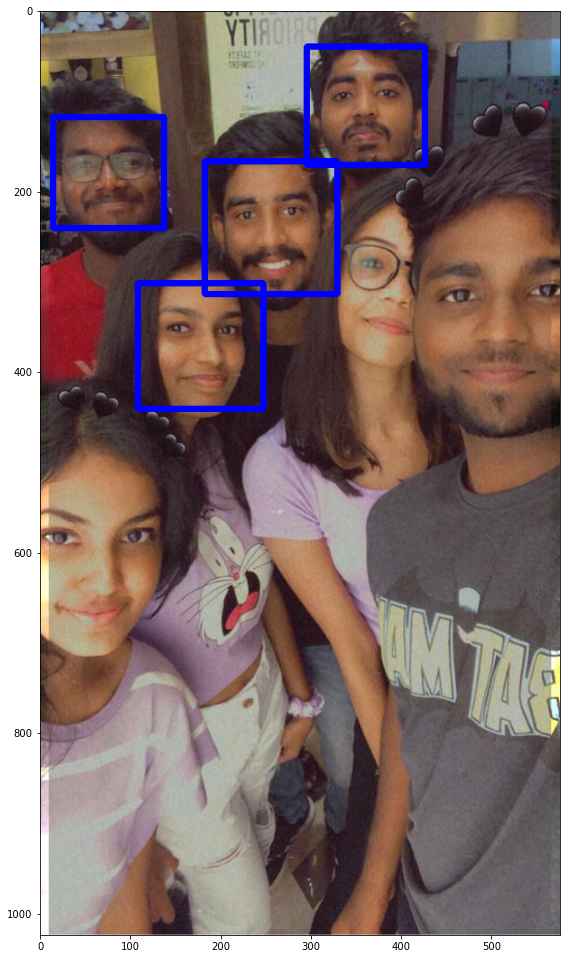

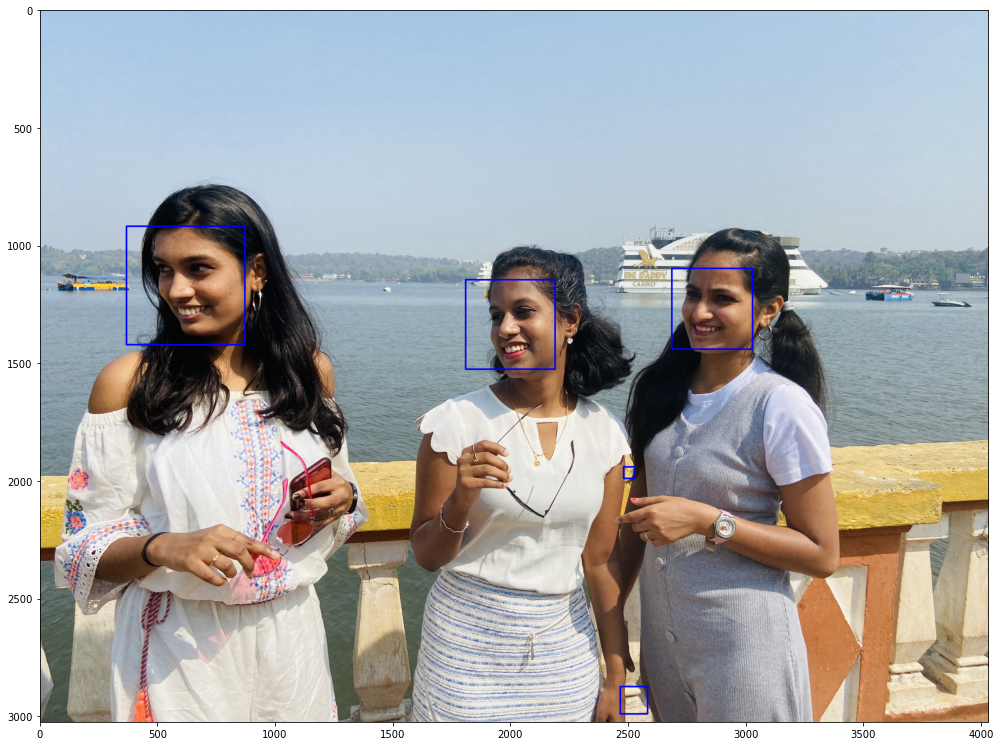

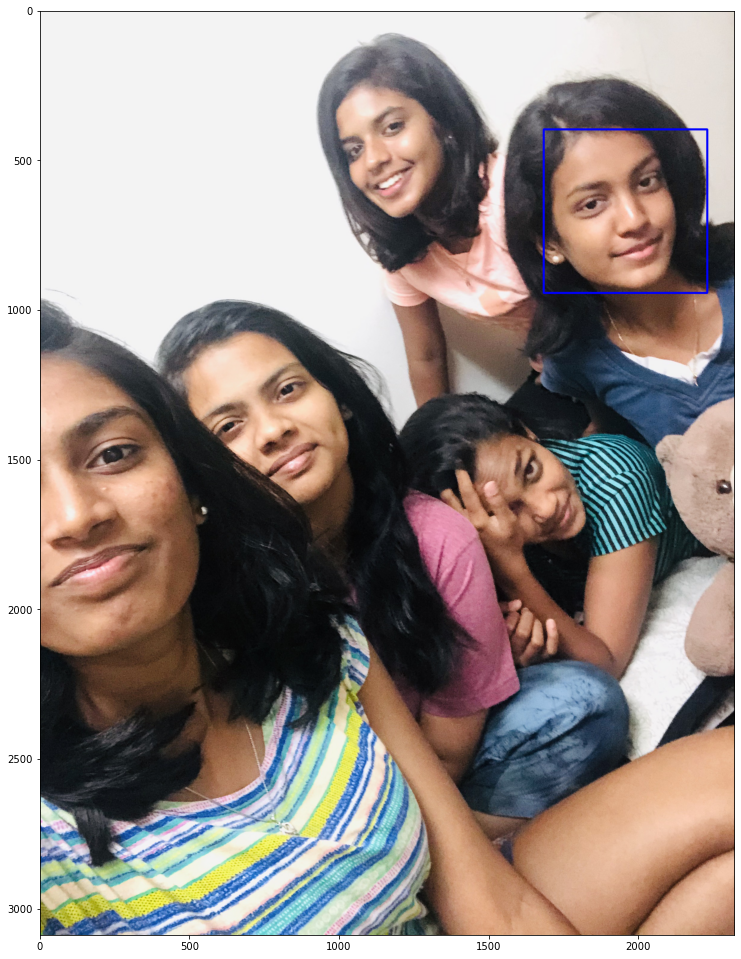

...

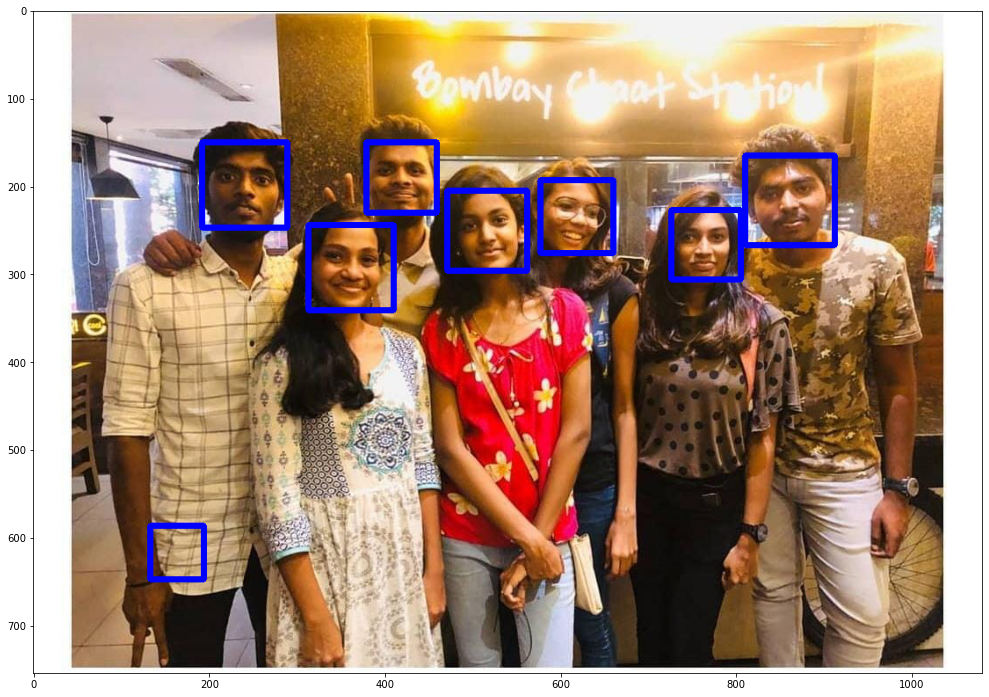

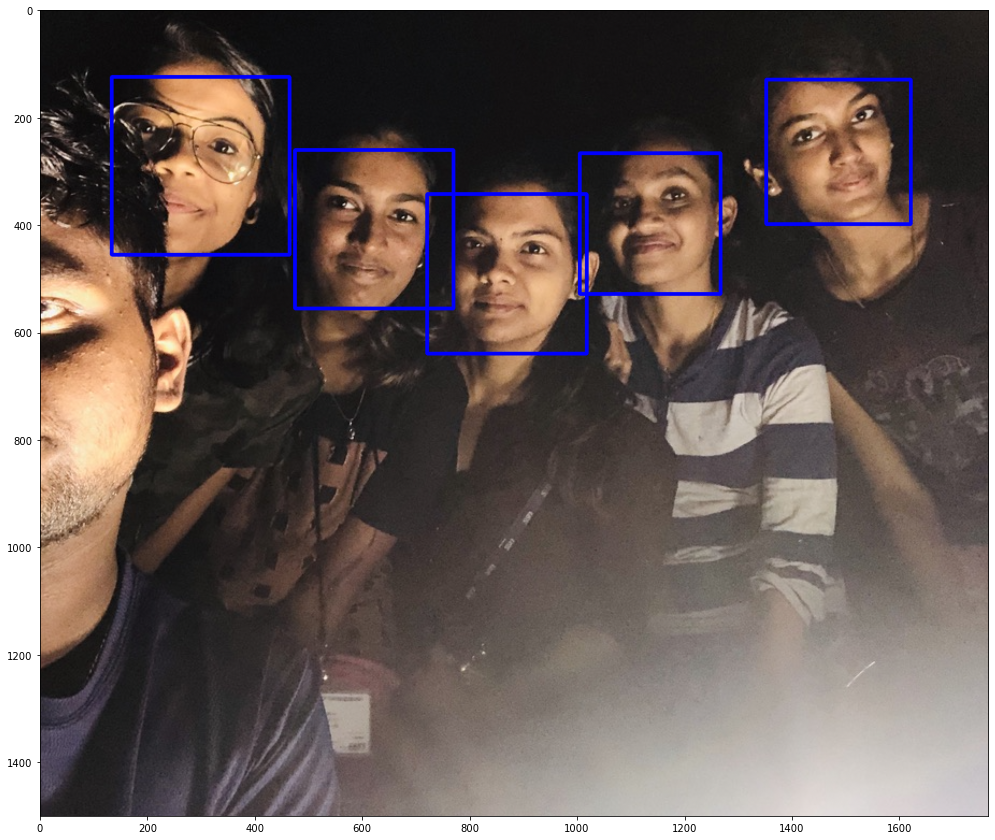

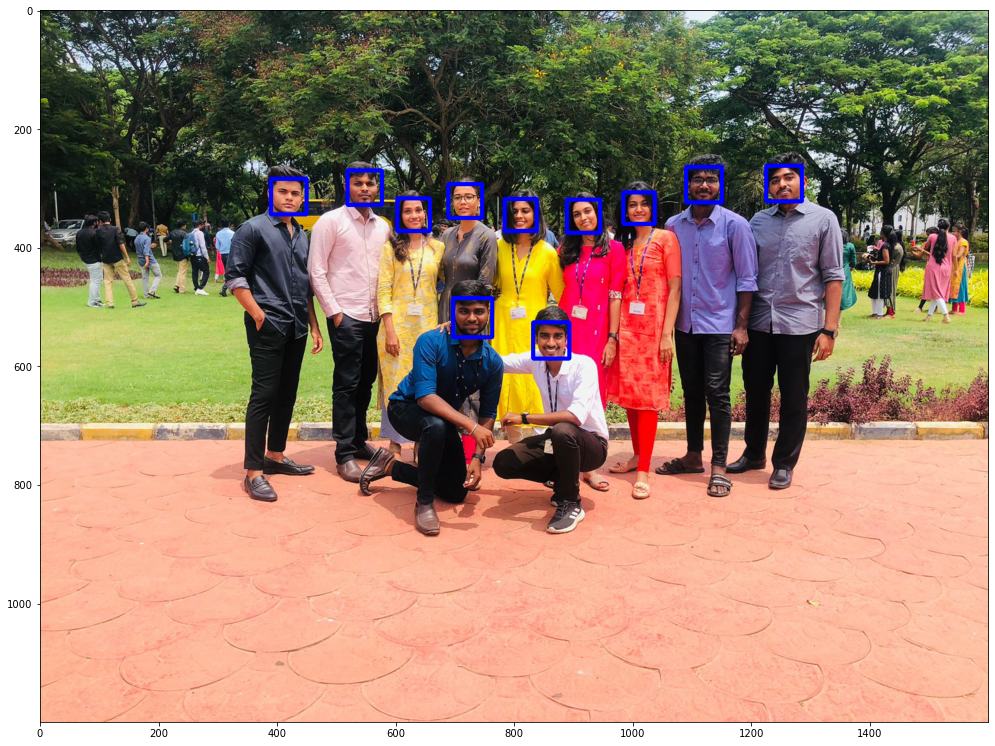

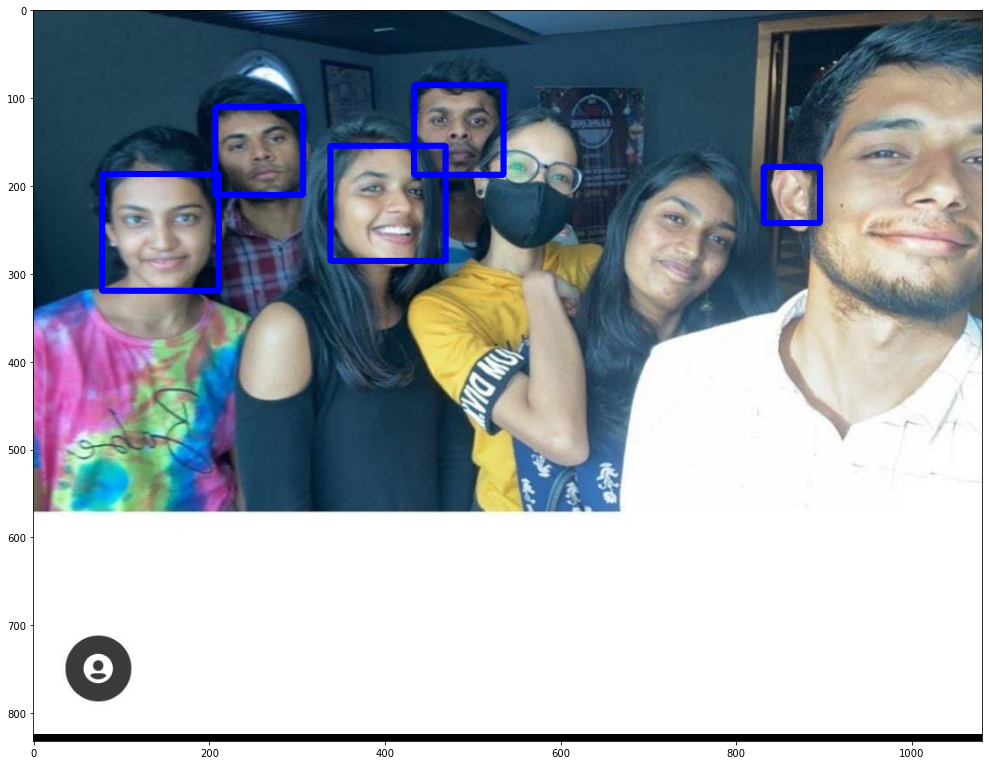

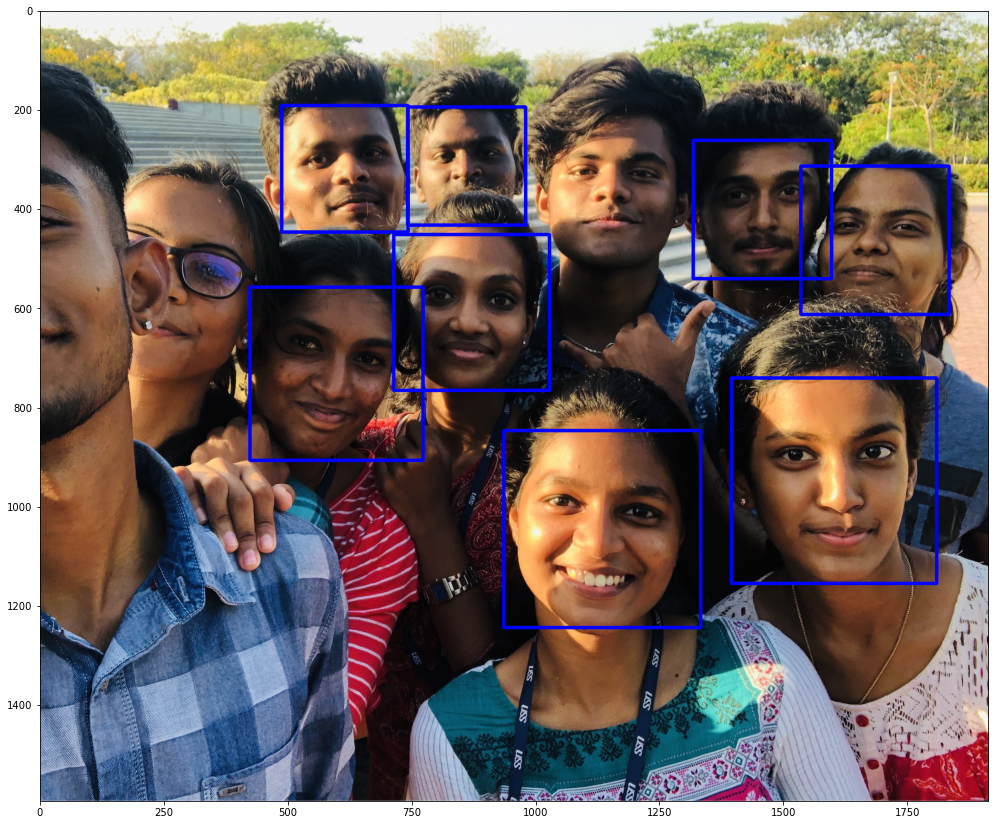

In [28]:
load_images_from_folder('Data/Custom/Split/Ph')